# Star Streak Finder

Code based on: https://github.com/dwkim78/ASTRiDE#4-how-to-use-astride

In [1]:
from __future__ import print_function, unicode_literals, absolute_import, division
import sys
import numpy as np
import matplotlib
matplotlib.rcParams["image.interpolation"] = None
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

/tmp/ipykernel_31626/4011289290.py:5: MatplotlibDeprecationWarning: Support for setting an rcParam that expects a str value to a non-str value is deprecated since 3.5 and support will be removed two minor releases later.
  matplotlib.rcParams["image.interpolation"] = None


### import

In [2]:
# !pip install --user astride

In [3]:
# # Import the ASTRiDE library.
# from astride import Streak
# # 
# # img = read_image('coadds/GenericCamera103-20230309-images1352-1512-coadd.fits')

# # Read a fits image and create a Streak instance.
# streak = Streak('coadds/GenericCamera103-20230309-images1352-1512-coadd.fits',
#                 contour_threshold=1.5, area_cut=100, radius_dev_cut=0.5, remove_bkg='map', output_path='./')

# # streak.raw_image = img

# # Detect streaks.
# streak.detect()

# # streak.streaks
# # streak.plot_figures()
# # plt.show()

In [5]:
# import pandas as pd

# df = pd.DataFrame(streak.streaks)
# df

In [6]:
def apply_filter(A, smoothing, power=2.0):
    """Apply a hi/lo pass filter to a 2D image.
    
    The value of smoothing specifies the cutoff wavelength in pixels,
    with a value >0 (<0) applying a hi-pass (lo-pass) filter. The
    lo- and hi-pass filters sum to one by construction.  The power
    parameter determines the sharpness of the filter, with higher
    values giving a sharper transition.
    """
    if smoothing == 0:
        return A
    ny, nx = A.shape
    # Round down dimensions to even values for rfft.
    # Any trimmed row or column will be unfiltered in the output.
    nx = 2 * (nx // 2)
    ny = 2 * (ny // 2)
    T = np.fft.rfft2(A[:ny, :nx])
    # Last axis (kx) uses rfft encoding.
    kx = np.fft.rfftfreq(nx)
    ky = np.fft.fftfreq(ny)
    kpow = (kx ** 2 + ky[:, np.newaxis] ** 2) ** (power / 2.)
    k0pow = (1. / smoothing) ** power
    if smoothing > 0:
        F = kpow / (k0pow + kpow) # high pass
    else:
        F = k0pow / (k0pow + kpow) # low pass
    S = A.copy()
    S[:ny, :nx] = np.fft.irfft2(T * F)
    return S

In [46]:
from astropy.io import fits
from scipy.stats import sigmaclip
from mpl_toolkits.axes_grid1 import make_axes_locatable

def display(imArr, nStd = 5, gSig = 7, ax=None):
    if ax is None:
        fig, ax = plt.subplots(1,1, figsize=(12,12))
    imArrClip, low, high = sigmaclip(imArr)
    mean = imArrClip.mean()
    std = imArrClip.std()
    im = ax.imshow(imArr, vmin=mean-nStd*std, vmax=mean+nStd*std, cmap='gray', origin='lower')
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right', size='5%', pad=0.05)
    plt.colorbar(im, cax=cax, orientation='vertical')
    plt.show()
    cax.cla()

def read_image(filename):
    with fits.open(filename) as hdu:
        imArr = hdu[0].data
    return imArr

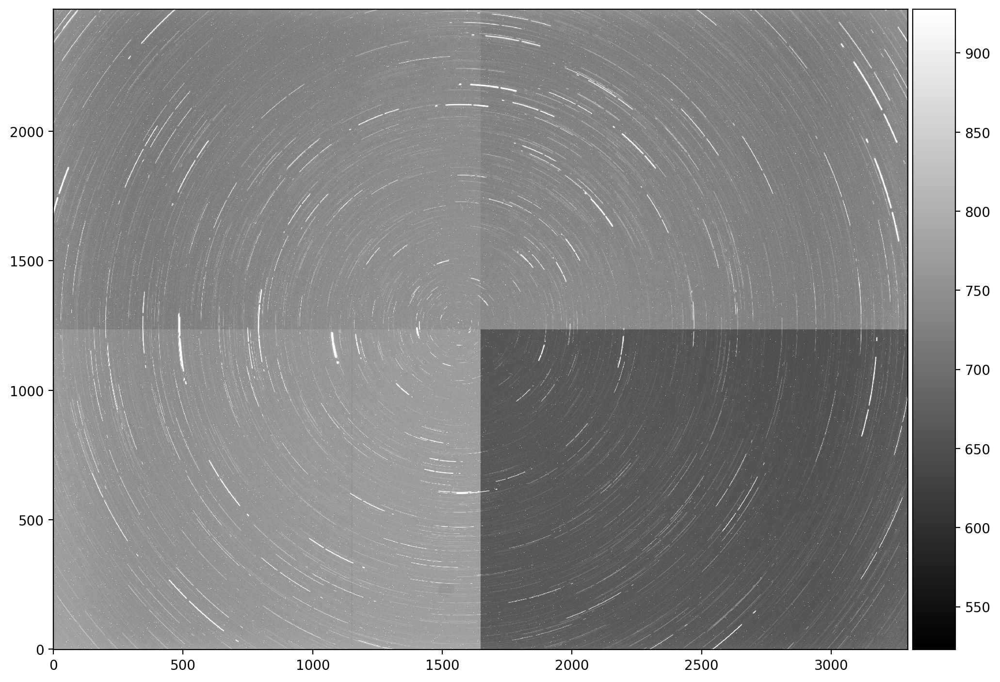

In [602]:
im = read_image('coadds/GenericCamera101-20230309-images1352-1512-coadd.fits')
display(im)

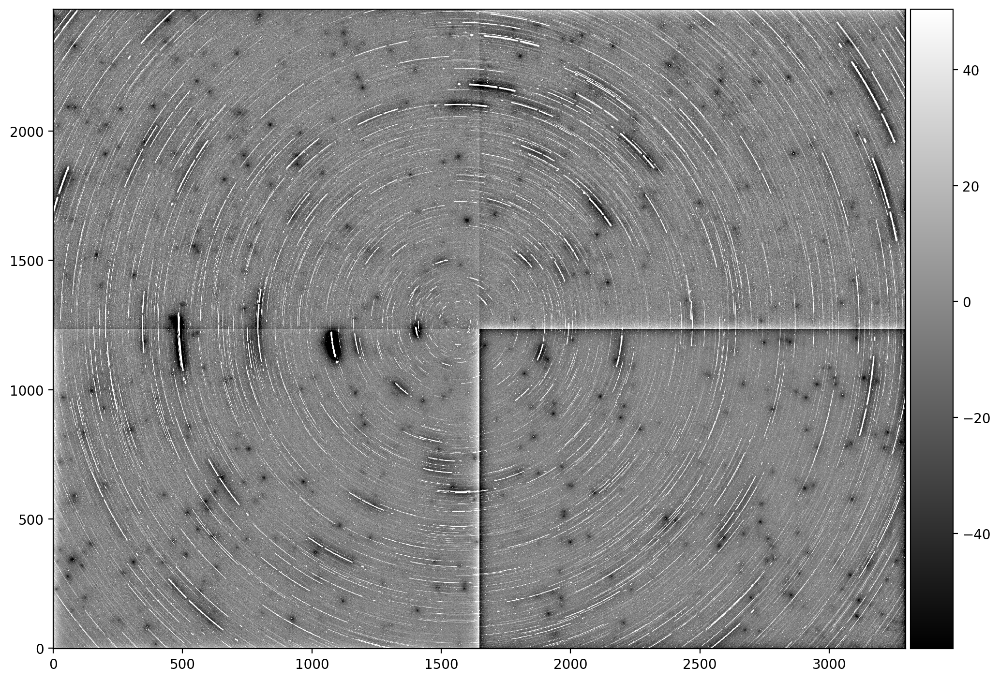

In [603]:
img1 = apply_filter(im, 100)
# img2 = apply_filter(img1, -1)
display(img1)

In [604]:
# from scipy.ndimage.filters import gaussian_filter
# img2 = gaussian_filter(img1, 5)
# display(img2)

In [605]:
# from skimage import filters
# img3 = filters.sobel(img1)
# display(img3)

In [606]:
# from skimage.morphology import closing, dilation
# from skimage.morphology import disk

# footprint = disk(5)
# img4 = dilation(img3, footprint)
# img4 = closing(img4, footprint)

# display(img4)

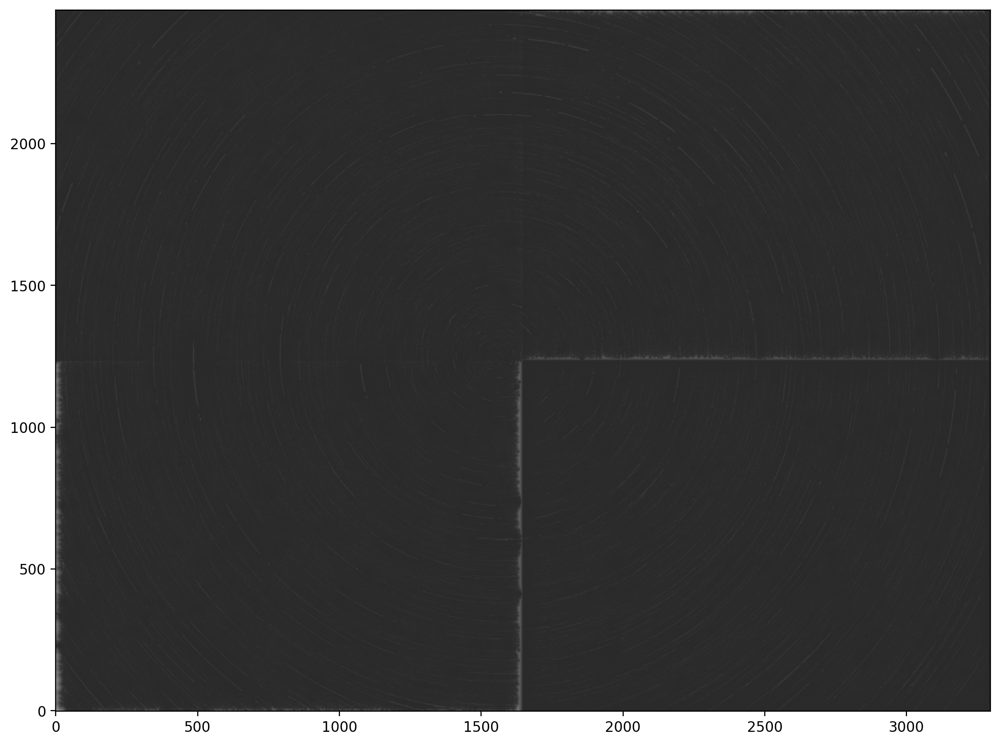

In [607]:
from skimage.filters import threshold_otsu, rank
from scipy import ndimage as ndi

thresh = threshold_otsu(img1)
# local_otsu = rank.otsu(img, footprint)

mask = img1 > 0
img5 = ndi.distance_transform_edt(mask)
plt.imshow(img5, origin='lower', vmin=-10, vmax=50, cmap='gray')

/tmp/ipykernel_31626/4175921264.py:3: DeprecationWarning: Please use `gaussian_filter` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  from scipy.ndimage.filters import gaussian_filter


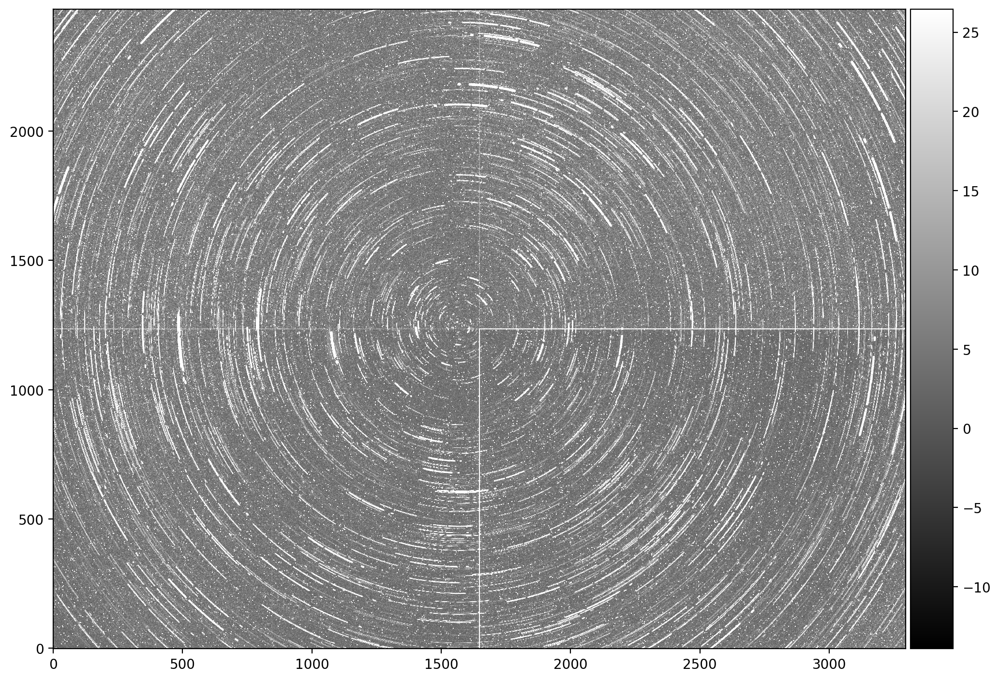

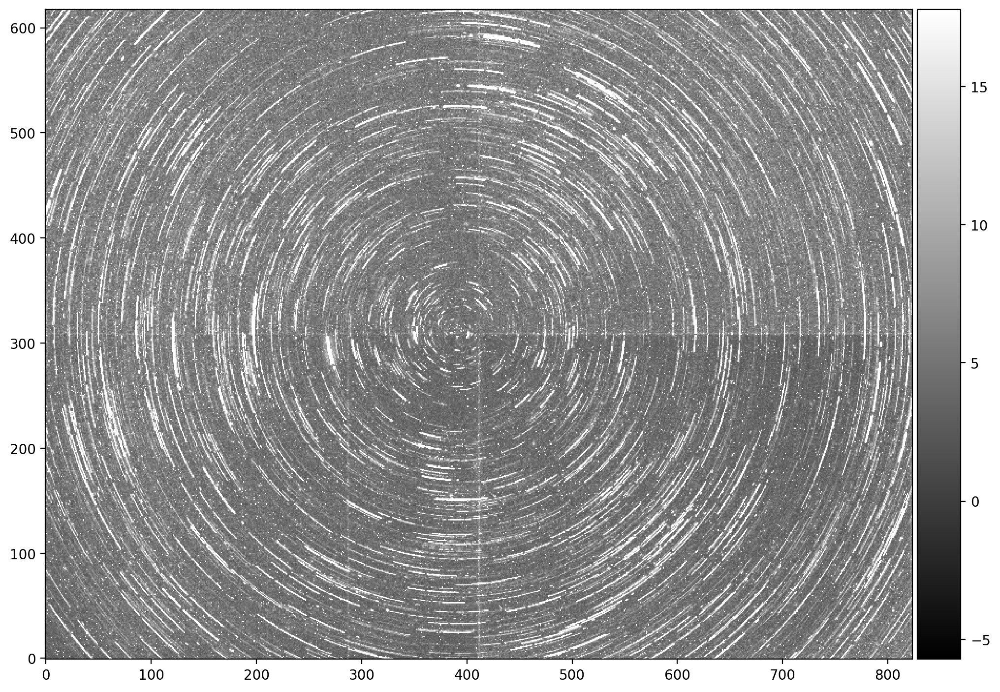

In [751]:
from skimage.measure import block_reduce
from skimage import filters
from scipy.ndimage.filters import gaussian_filter

img = apply_filter(im, 100)
img1 = filters.sobel(img)
display(img1)

downscale = 4
img2 = block_reduce(img1, (downscale, downscale), func=np.nanmedian)
display(img2)

In [609]:
# from scipy import ndimage as ndi
# img1 = apply_filter(im, 100)
# display(img1)
# img2 = img1
# # mask = img1 > 0
# # img2 = ndi.distance_transform_edt(mask)
# # display(img2)

In [640]:
# Import the ASTRiDE library.
from astride import Streak

# Read a fits image and create a Streak instance.
streak = Streak('coadds/GenericCamera101-20230309-images1352-1512-coadd.fits',
                contour_threshold=1.24, area_cut=75, radius_dev_cut=0.35,remove_bkg='map', output_path='./')

streak.raw_image = img2

# Detect streaks.
streak.detect()

df = pd.DataFrame(streak.streaks)
df

,index,x,y,x_center,y_center,perimeter,area,shape_factor,radius_deviation,slope,intercept,connectivity,x_min,x_max,y_min,y_max,box_plotted,slope_angle
0,1,"[195.0, 194.91624309037047, 195.0, 195.2983328...","[23.095618089303123, 23.0, 22.76196460945277, ...",209.062416,10.429860,106.894124,76.225757,0.083831,0.517591,-0.633925,143.183840,-1,189.013189,226.820676,0.277410,23.933904,False,-32.371649
1,2,"[288.0, 287.5566719964919, 287.0, 286.27090972...","[22.321881629019668, 22.0, 21.677333570830292,...",313.349376,9.814602,177.974664,163.201964,0.064747,0.527611,-0.253437,89.378198,-1,280.565487,353.360675,1.157021,22.321882,False,-14.221460
2,3,"[726.0, 725.5152629461066, 726.0, 726.15633754...","[103.5789821841603, 103.0, 102.31286162954227,...",679.190474,51.018007,392.961413,380.807767,0.030990,0.514264,1.013281,-636.906470,-1,625.070311,727.729268,1.013925,103.578982,False,45.377961
3,4,"[73.0, 72.0, 71.40228292151554, 72.0, 72.50448...","[98.82973709079101, 98.90246003686005, 98.0, 9...",102.846714,46.959387,1044.254185,1317.932658,0.015188,0.574379,-0.930252,147.031067,-1,68.220335,138.492940,3.815085,98.902460,False,-42.930560
4,5,"[583.2905075507426, 584.0, 585.0, 585.06763856...","[25.0, 24.54026817563407, 24.361477780836594, ...",567.598880,14.952959,112.453464,114.635468,0.113916,0.593498,0.530083,-285.778591,-1,548.116881,586.706196,3.611398,25.252708,False,27.927319
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
277,278,"[630.9686594037372, 631.0, 631.4400975177527, ...","[606.0, 605.9299594597072, 605.0, 604.64910803...",642.055230,593.027595,154.339903,253.919781,0.133952,0.425153,-0.696808,1039.628561,-1,627.659208,657.562501,580.501986,606.013635,False,-34.869081
278,279,"[150.0, 149.0, 148.26316627110276, 148.0, 147....","[616.9126394698503, 616.8898015581353, 616.0, ...",133.254680,601.572990,132.091188,123.027786,0.088606,0.606758,0.873151,485.165604,-1,115.272395,152.089721,582.695514,616.912639,False,41.125859
279,280,"[598.0, 597.9177093609317, 598.0, 598.51387232...","[615.045632275699, 615.0, 614.9296198238728, 6...",614.573793,600.246762,123.378368,85.010920,0.070179,0.578354,-0.759817,1067.211898,-1,593.664725,632.473282,586.446140,615.365456,False,-37.228201
280,281,"[406.0, 405.0, 404.0, 403.0, 402.0, 401.761188...","[594.3639778431137, 594.5473777973854, 594.863...",393.630191,591.329864,107.616524,90.534382,0.098235,0.652916,-0.014724,596.985985,-1,372.302589,406.791660,587.036257,594.863915,False,-0.843578


In [663]:
np.argmax(df.radius_deviation)

196

In [742]:
def fit_ellipse(x, y):
    """

    Fit the coefficients a,b,c,d,e,f, representing an ellipse described by
    the formula F(x,y) = ax^2 + bxy + cy^2 + dx + ey + f = 0 to the provided
    arrays of data points x=[x1, x2, ..., xn] and y=[y1, y2, ..., yn].

    Based on the algorithm of Halir and Flusser, "Numerically stable direct
    least squares fitting of ellipses'.


    """
    D1 = np.vstack([x**2, x*y, y**2]).T
    D2 = np.vstack([x, y, np.ones(len(x))]).T
    S1 = D1.T @ D1
    S2 = D1.T @ D2
    S3 = D2.T @ D2
    T = -np.linalg.inv(S3) @ S2.T
    M = S1 + S2 @ T
    C = np.array(((0, 0, 2), (0, -1, 0), (2, 0, 0)), dtype=float)
    M = np.linalg.inv(C) @ M
    eigval, eigvec = np.linalg.eig(M)
    con = 4 * eigvec[0]* eigvec[2] - eigvec[1]**2
    ak = eigvec[:, np.nonzero(con > 0)[0]]
    return np.concatenate((ak, T @ ak)).ravel()

def fit_ellipse_image(x, y, w):
    """

    Fit the coefficients a,b,c,d,e,f, representing an ellipse described by
    the formula F(x,y) = ax^2 + bxy + cy^2 + dx + ey + f = 0 to the provided
    arrays of data points x=[x1, x2, ..., xn] and y=[y1, y2, ..., yn].

    Based on the algorithm of Halir and Flusser, "Numerically stable direct
    least squares fitting of ellipses'.


    """
    D10 = np.vstack([x**2, x*y, y**2]).T
    D20 = np.vstack([x, y, np.ones(len(x))]).T
    D1 = D10 @ np.tile(w, [3,1])
    D2 = D20 @ np.tile(w, [3,1])

    S1 = D1.T @ D1
    S2 = D1.T @ D2
    S3 = D2.T @ D2
    
    T = -np.linalg.inv(S3) @ S2.T
    M = S1 + S2 @ T
    C = np.array(((0, 0, 2), (0, -1, 0), (2, 0, 0)), dtype=float)
    M = np.linalg.inv(C) @ M
    eigval, eigvec = np.linalg.eig(M)
    con = 4 * eigvec[0]* eigvec[2] - eigvec[1]**2
    ak = eigvec[:, np.nonzero(con > 0)[0]]
    return np.concatenate((ak, T @ ak)).ravel()

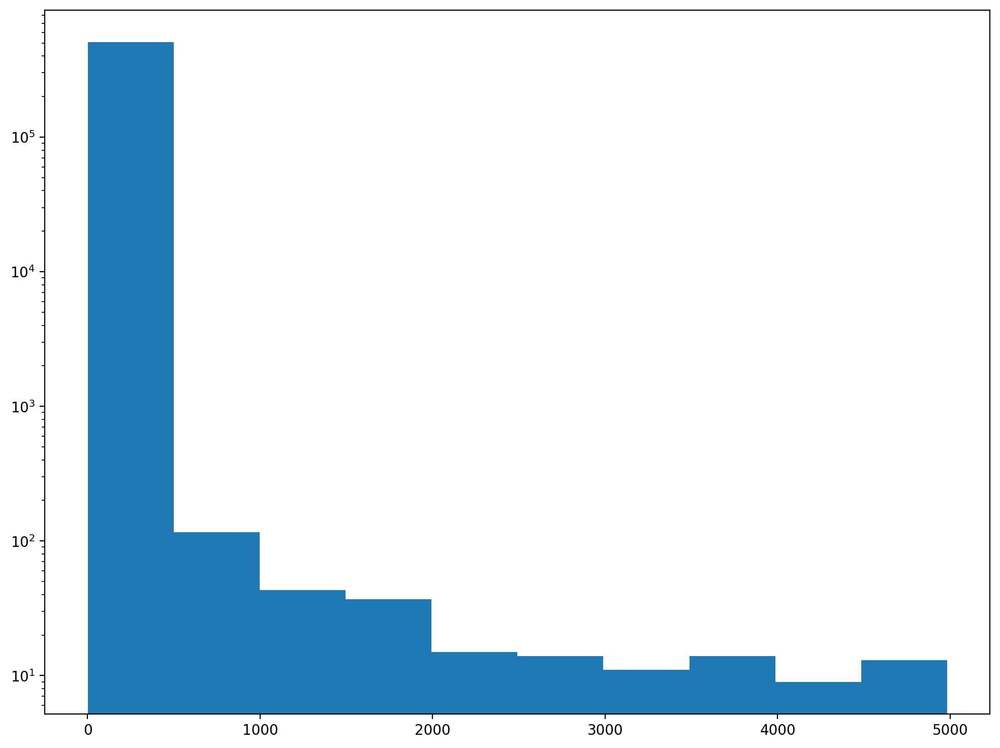

In [752]:
plt.hist(img2.flatten())
plt.yscale('log')

In [ ]:
y2,x2 = np.mgrid[0:im.shape[0], 0:im.shape[1]]
w2 = img2
# w2 = np.where(im>0, img, 0)

idx = np.where(img2>0)
coefs = fit_ellipse_image(x2[idx].flatten(), y2[idx].flatten(), w2[idx].flatten())

print('Fitted parameters:')
print('a, b, c, d, e, f =', coeffs)
x0, y0, ap, bp, e, phi = cart_to_pol(coeffs)
print('x0, y0, ap, bp, e, phi = ', x0, y0, ap, bp, e, phi)
x, y = get_ellipse_pts((x0, y0, ap, bp, e, phi))
plt.plot(x, y)
plt.show()

In [725]:
help(np.repeat)

Help on function repeat in module numpy:

repeat(a, repeats, axis=None)
    Repeat elements of an array.
    
    Parameters
    ----------
    a : array_like
        Input array.
    repeats : int or array of ints
        The number of repetitions for each element.  `repeats` is broadcasted
        to fit the shape of the given axis.
    axis : int, optional
        The axis along which to repeat values.  By default, use the
        flattened input array, and return a flat output array.
    
    Returns
    -------
    repeated_array : ndarray
        Output array which has the same shape as `a`, except along
        the given axis.
    
    See Also
    --------
    tile : Tile an array.
    unique : Find the unique elements of an array.
    
    Examples
    --------
    >>> np.repeat(3, 4)
    array([3, 3, 3, 3])
    >>> x = np.array([[1,2],[3,4]])
    >>> np.repeat(x, 2)
    array([1, 1, 2, 2, 3, 3, 4, 4])
    >>> np.repeat(x, 3, axis=1)
    array([[1, 1, 1, 2, 2, 2],
           [

In [730]:
# np.repeat(img, [1,3])

array([431.17893435, 431.20761532, 431.190362  , 431.12724384,
       431.018515  , 430.86461331, 430.66615846, 430.42394957,
       430.13896192, 429.81234306, 429.44540816, 429.03963475,
       428.59665674, 428.11825782, 427.60636436, 427.06303757,
       426.49046522, 425.89095287, 425.26691454, 424.62086302,
       423.95539972, 423.27320423, 422.57702351, 421.86966084,
       421.15396452, 420.43281639, 419.70912028, 418.98579024,
       418.26573888, 417.55186559, 416.84704488, 416.15411482,
       415.47586559, 414.81502826, 414.17426379, 413.55615231,
       412.96318275, 412.39774277, 411.86210921, 411.35843887,
       410.88875986, 410.45496341, 410.05879626, 409.70185364,
       409.38557283, 409.11122738, 408.87992198, 408.69258802,
       408.54997983, 408.45267164, 408.40105528, 408.39533858,
       408.43554456, 408.52151134, 408.65289275, 408.82915976,
       409.04960261, 409.31333366, 409.61929096, 409.96624251,
       410.35279127, 410.77738075, 411.23830127, 411.73

In [700]:
w = y
X = np.vstack([x**2, x*y, y**2, x, y]).T
X2 =  np.vstack([w*x**2, w*x*y, w*y**2, w*x, w*y]).T

Xs = np.sum(X,axis=0)
Xs2 = np.sum(X2,axis=0)

a = np.sum(Xs2)/(Xs*Xs2)
a

array([4.66522402e-05, 1.81121273e-06, 7.02155570e-08, 3.19808656e-01,
       1.23947805e-02])

Fitted parameters:
a, b, c, d, e, f = [-8.75353331e-01  4.66875148e-01 -1.25634959e-01 -5.13343343e+01
  6.69054994e+01 -1.19143538e+04]
x0, y0, ap, bp, e, phi =  82.62941590982355 419.8000345089493 11.834858334228075 2.9589887979231597 0.9682398537726262 1.2923122275150924


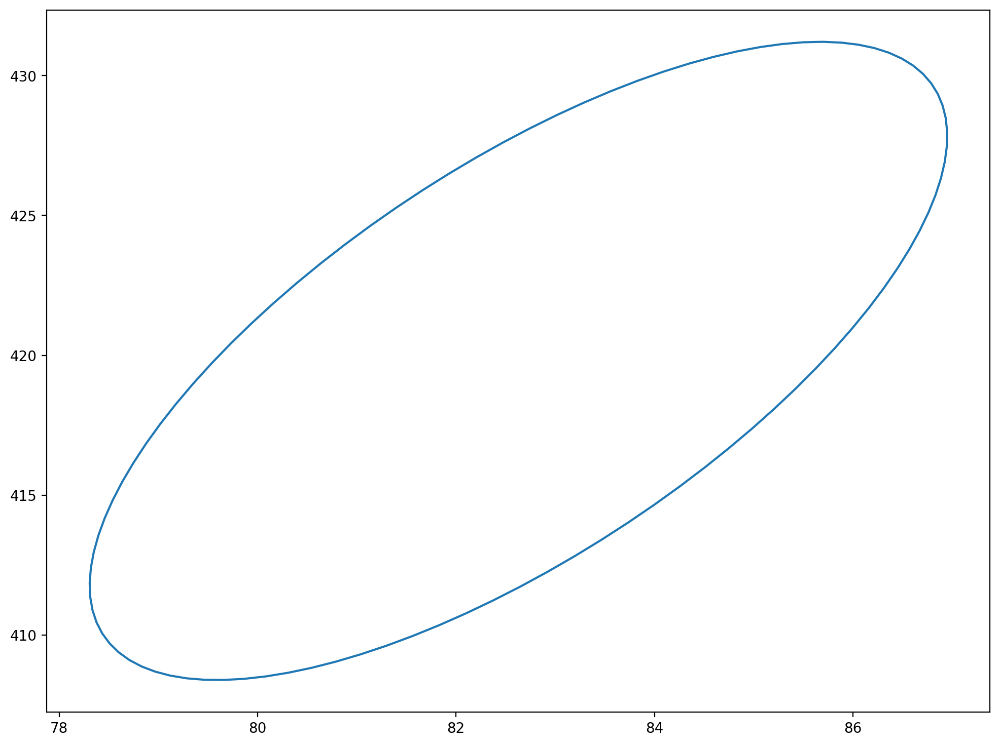

In [714]:
y2,x2 = np.mgrid[0:im.shape[0], 0:im.shape[1]]
w2 = im
# w2 = np.where(im>0, img, 0)

coefs = fit_ellipse_image(x2.flatten(), y2.flatten(), w2.flatten())

print('Fitted parameters:')
print('a, b, c, d, e, f =', coeffs)
x0, y0, ap, bp, e, phi = cart_to_pol(coeffs)
print('x0, y0, ap, bp, e, phi = ', x0, y0, ap, bp, e, phi)
x, y = get_ellipse_pts((x0, y0, ap, bp, e, phi))
plt.plot(x, y)
plt.show()

In [668]:
#     def _compute_covariance(self):
#         """Computes the covariance matrix for each Gaussian kernel using
#         covariance_factor().
#         """
#         self.factor = self.covariance_factor()
#         # Cache covariance and inverse covariance of the data
#         if not hasattr(self, '_data_inv_cov'):
#             # Compute the mean and residuals
#             _mean = np.sum(self.weights * self.dataset, axis=1)
#             _residual = (self.dataset - _mean[:, None])
#             # Compute the biased covariance
#             self._data_covariance = np.atleast_2d(np.dot(_residual * self.weights, _residual.T))
#             # Correct for bias (http://en.wikipedia.org/wiki/Weighted_arithmetic_mean#Weighted_sample_covariance)
#             self._data_covariance /= (1 - np.sum(self.weights ** 2))
#             self._data_inv_cov = np.linalg.inv(self._data_covariance)

#         self.covariance = self._data_covariance * self.factor**2
#         self.inv_cov = self._data_inv_cov / self.factor**2
#         self._norm_factor = np.sqrt(np.linalg.det(2*np.pi*self.covariance)) #* self.n

In [707]:
print('Fitted parameters:')
print('a, b, c, d, e, f =', coeffs)
x0, y0, ap, bp, e, phi = cart_to_pol(coeffs)
print('x0, y0, ap, bp, e, phi = ', x0, y0, ap, bp, e, phi)


Fitted parameters:
a, b, c, d, e, f = [-8.75353331e-01  4.66875148e-01 -1.25634959e-01 -5.13343343e+01
  6.69054994e+01 -1.19143538e+04]
x0, y0, ap, bp, e, phi =  82.62941590982355 419.8000345089493 11.834858334228075 2.9589887979231597 0.9682398537726262 1.2923122275150924


In [665]:
x, y = edges[196]['x'], edges[196]['y']
coeffs = fit_ellipse(x,y)
coeffs

array([-8.75353331e-01,  4.66875148e-01, -1.25634959e-01, -5.13343343e+01,
        6.69054994e+01, -1.19143538e+04])

Fitted parameters:
a, b, c, d, e, f = [-8.75353331e-01  4.66875148e-01 -1.25634959e-01 -5.13343343e+01
  6.69054994e+01 -1.19143538e+04]
x0, y0, ap, bp, e, phi =  82.62941590982355 419.8000345089493 11.834858334228075 2.9589887979231597 0.9682398537726262 1.2923122275150924


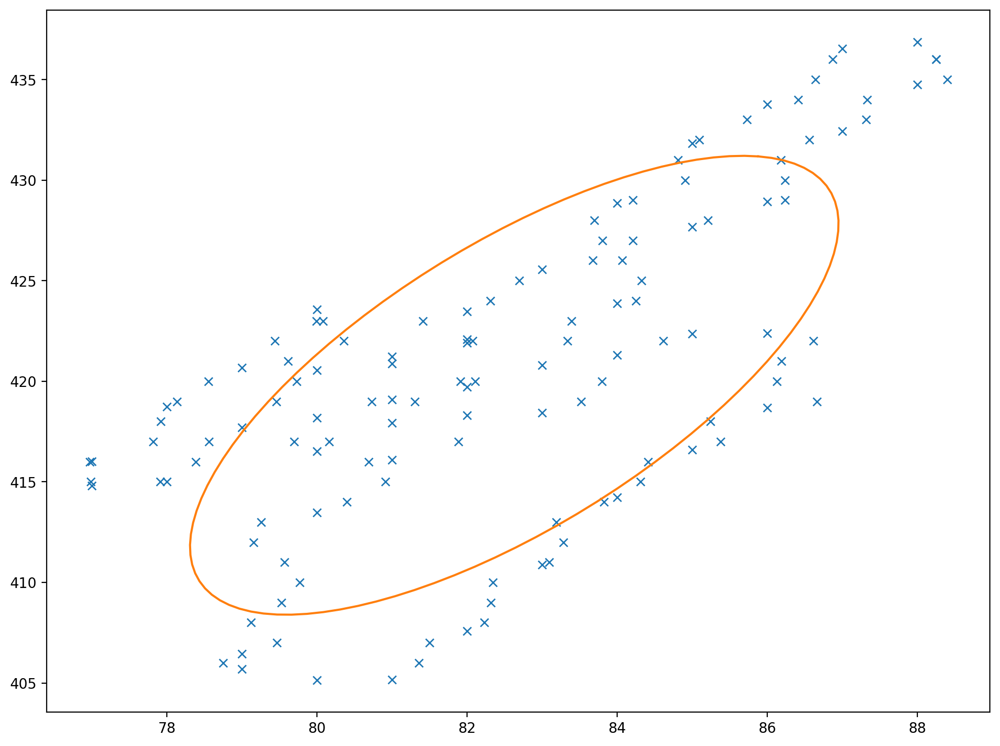

In [666]:
print('Fitted parameters:')
print('a, b, c, d, e, f =', coeffs)
x0, y0, ap, bp, e, phi = cart_to_pol(coeffs)
print('x0, y0, ap, bp, e, phi = ', x0, y0, ap, bp, e, phi)

plt.plot(x, y, 'x')     # given points
x, y = get_ellipse_pts((x0, y0, ap, bp, e, phi))
plt.plot(x, y)
plt.show()

In [659]:
def cart_to_pol(coeffs):
    """

    Convert the cartesian conic coefficients, (a, b, c, d, e, f), to the
    ellipse parameters, where F(x, y) = ax^2 + bxy + cy^2 + dx + ey + f = 0.
    The returned parameters are x0, y0, ap, bp, e, phi, where (x0, y0) is the
    ellipse centre; (ap, bp) are the semi-major and semi-minor axes,
    respectively; e is the eccentricity; and phi is the rotation of the semi-
    major axis from the x-axis.

    """

    # We use the formulas from https://mathworld.wolfram.com/Ellipse.html
    # which assumes a cartesian form ax^2 + 2bxy + cy^2 + 2dx + 2fy + g = 0.
    # Therefore, rename and scale b, d and f appropriately.
    a = coeffs[0]
    b = coeffs[1] / 2
    c = coeffs[2]
    d = coeffs[3] / 2
    f = coeffs[4] / 2
    g = coeffs[5]

    den = b**2 - a*c
    if den > 0:
        raise ValueError('coeffs do not represent an ellipse: b^2 - 4ac must'
                         ' be negative!')

    # The location of the ellipse centre.
    x0, y0 = (c*d - b*f) / den, (a*f - b*d) / den

    num = 2 * (a*f**2 + c*d**2 + g*b**2 - 2*b*d*f - a*c*g)
    fac = np.sqrt((a - c)**2 + 4*b**2)
    # The semi-major and semi-minor axis lengths (these are not sorted).
    ap = np.sqrt(num / den / (fac - a - c))
    bp = np.sqrt(num / den / (-fac - a - c))

    # Sort the semi-major and semi-minor axis lengths but keep track of
    # the original relative magnitudes of width and height.
    width_gt_height = True
    if ap < bp:
        width_gt_height = False
        ap, bp = bp, ap

    # The eccentricity.
    r = (bp/ap)**2
    if r > 1:
        r = 1/r
    e = np.sqrt(1 - r)

    # The angle of anticlockwise rotation of the major-axis from x-axis.
    if b == 0:
        phi = 0 if a < c else np.pi/2
    else:
        phi = np.arctan((2.*b) / (a - c)) / 2
        if a > c:
            phi += np.pi/2
    if not width_gt_height:
        # Ensure that phi is the angle to rotate to the semi-major axis.
        phi += np.pi/2
    phi = phi % np.pi

    return x0, y0, ap, bp, e, phi


def get_ellipse_pts(params, npts=100, tmin=0, tmax=2*np.pi):
    """
    Return npts points on the ellipse described by the params = x0, y0, ap,
    bp, e, phi for values of the parametric variable t between tmin and tmax.

    """

    x0, y0, ap, bp, e, phi = params
    # A grid of the parametric variable, t.
    t = np.linspace(tmin, tmax, npts)
    x = x0 + ap * np.cos(t) * np.cos(phi) - bp * np.sin(t) * np.sin(phi)
    y = y0 + ap * np.cos(t) * np.sin(phi) + bp * np.sin(t) * np.cos(phi)
    return x, y


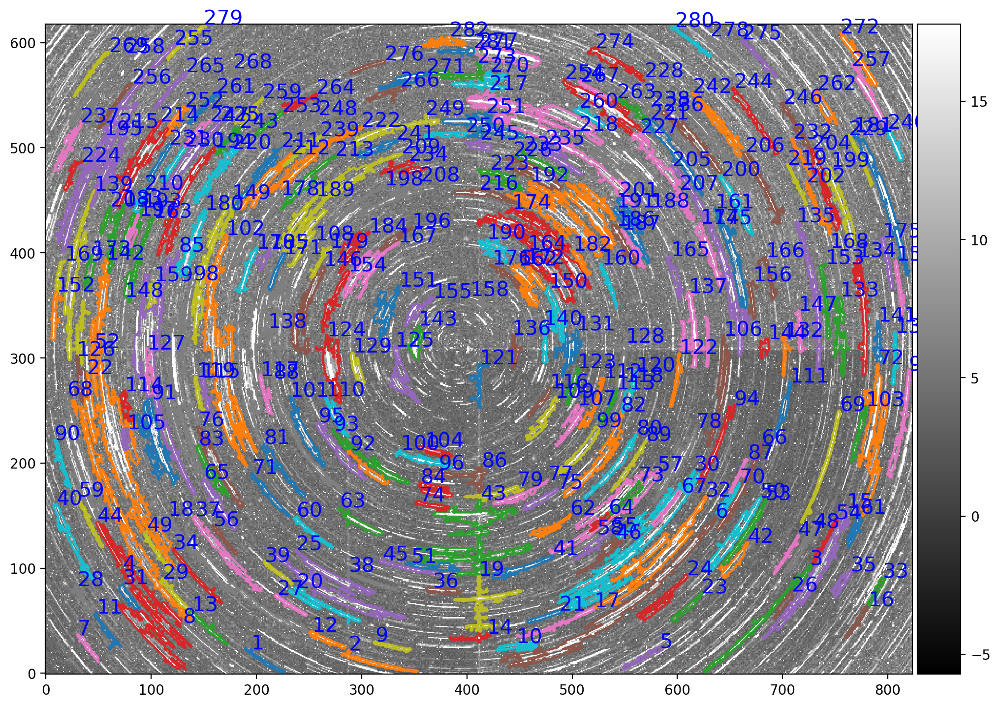

In [641]:
fig, (ax1) = plt.subplots(1,1, figsize=(12,12), sharex='all', sharey='all')

edges = streak.streaks
# Plot all contours.
for n, edge in enumerate(edges):
    ax1.plot(edge['x'], edge['y'],mfc='o',mec='r',ms=5)
    ax1.text(edge['x'][0], edge['y'][1],
            '%d' % (edge['index']), color='b', fontsize=15)

display(img2, ax=ax1)

# plt.plot(df.x_center, df.y_center, 'ro')

In [642]:
# mask streaks
mask = np.zeros_like(img2)

for n, edge in enumerate(edges):
    if edge['index']!= 77:
        x, y = edge['x'].astype(int), edge['y'].astype(int)
        mask[y,x] = 1.

In [643]:
from skimage.morphology import closing, dilation
from skimage.morphology import disk

footprint = disk(2)
mask = dilation(mask, footprint)
mask = closing(mask, footprint)

# display(img5)

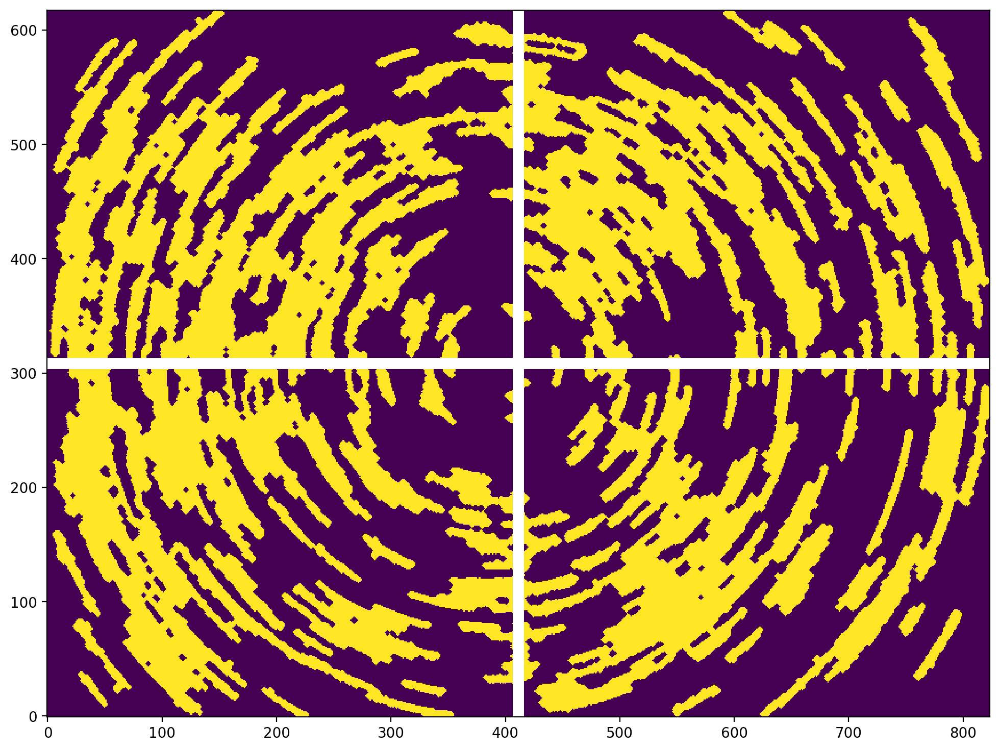

In [644]:
xmax = int(img2.shape[0])
ymax = int(img2.shape[1])
xmid = int(xmax/2)
ymid = int(ymax/2)

## mask = np.ones_like(img2)
mask[xmid-5:xmid+5,:] = np.nan
mask[:,ymid-5:ymid+5] = np.nan
# mask[xmid:-1,ymid:ymid+40] = np.nan
# mask[xmid:xmid+40,ymid:-1] = np.nan
plt.imshow(mask, origin='lower')

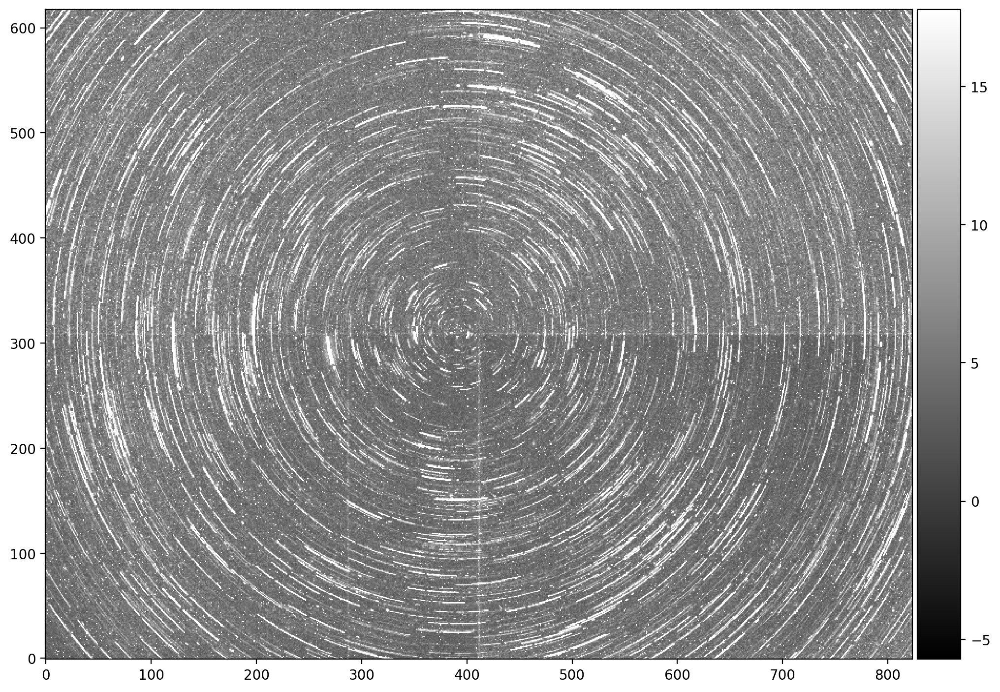

In [645]:
display(img2)

In [623]:
# img2 = im.copy()

In [629]:
from scipy.stats import binned_statistic_2d, binned_statistic
import scipy.optimize as opt

# Pixel coordinate grid

y2,x2 = np.mgrid[0:img2.shape[0], 0:img2.shape[1]]

def fn_detect(p):
    '''Estimator to locate tree rings center in downscaled images'''
    r = np.hypot(x2-p[0], y2-p[1])
    rmax = np.max(r)
    idx = np.isfinite(mask) & (mask != 0)
    v,bins,_ = binned_statistic(r[idx], img2[idx], bins=np.arange(np.min(r)+10, rmax, 1.0))
    return -np.std(v[np.isfinite(v)])

def signal(p):
    '''Estimator to locate tree rings center in downscaled images'''
    r = np.hypot(x2-p[0], y2-p[1])
    rmax = np.max(r)
    idx = np.isfinite(mask) & (mask != 0)
    v,bins,_ = binned_statistic(r[idx], img2[idx], bins=np.arange(np.percentile(r,5), rmax, 1.0))
    return v, bins[1:]

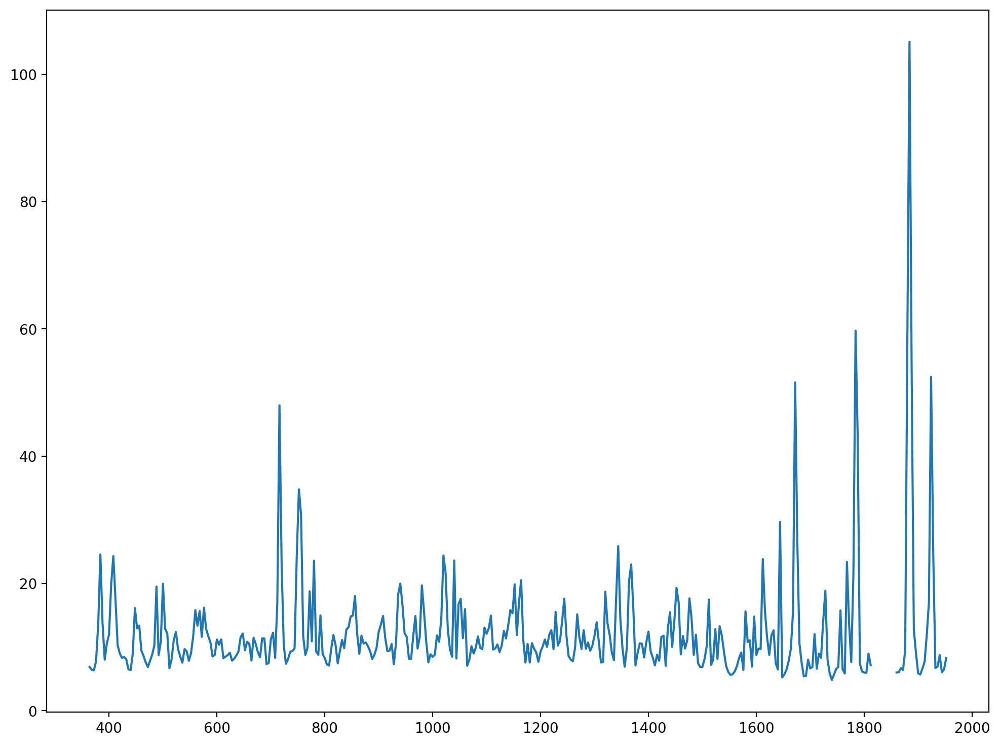

In [630]:
# x0, y0 = 1890, 900
# x0, y0 = 1100, -200
s, rs = signal([x0/downscale, y0/downscale])
plt.plot(rs*downscale, s)


In [647]:
xmax = img2.shape[0]
# xlow, xhig = xmax, 1300
# ylow, yhig = -300, -100
xlow, xhig = 1500, 1700
ylow, yhig = 1200, 1300
# ylow, yhig = 800, 1120
# xlow, xhig = 1700, 2000

cc = opt.differential_evolution(fn_detect,[[xlow/downscale,xhig/downscale],[ylow/downscale,yhig/downscale]], popsize=40, workers=20)
print(cc)

x0,y0 = cc.x[0]*downscale, cc.x[1]*downscale
print()
print("Original scale coordinates: %.2f, %.2f"%(x0, y0))

/opt/lsst/software/stack/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe-5.1.0/lib/python3.10/site-packages/scipy/optimize/_differentialevolution.py:377: UserWarning: differential_evolution: the 'workers' keyword has overridden updating='immediate' to updating='deferred'
  with DifferentialEvolutionSolver(func, bounds, args=args,


     fun: -11.62970159728026
 message: 'Optimization terminated successfully.'
    nfev: 2963
     nit: 36
 success: True
       x: array([375.88995891, 307.85816161])

Original scale coordinates: 1503.56, 1231.43


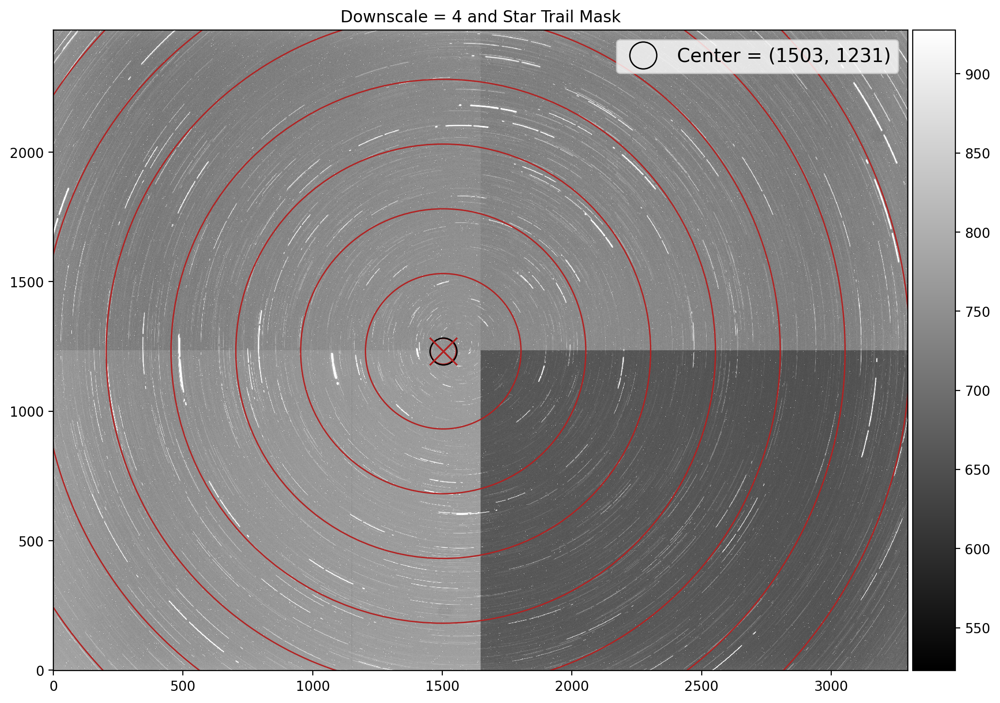

<Figure size 1200x900 with 0 Axes>

In [648]:
from matplotlib.patches import Circle
fig, (ax1) = plt.subplots(1,1, figsize=(12,12), sharex='all', sharey='all')

ax1.plot(x0,y0,'ro',mfc='none',mec='k',ms=20,label='Center = (%i, %i)'%(x0,y0))
ax1.legend(fontsize=14)
for _ in np.arange(50, 2000, 250):
    plt.gca().add_patch(Circle((x0, y0), _, color='firebrick', ls='-', fc='none'))
    ax1.plot(x0,y0,'rx',mec='firebrick',ms=20,label='Center')

# ax1.set_xlim(0, x0+30)
# ax1.set_ylim(y0-30, ymax)

ax1.set_title('Downscale = %i and Star Trail Mask'%downscale)
display(im,ax=ax1)
plt.savefig('star_trail_centroid_103.png', dpi=120)

In [80]:
# mask[mask>0]

In [8]:
# Write outputs and plot figures.
streak.write_outputs()


In [4]:
# Detect streaks.
help(streak.detect)



Help on method detect in module astride.detect:

detect() method of astride.detect.Streak instance
    Run the pipeline to detect streaks.



In [5]:
help(Streak)

Help on class Streak in module astride.detect:

class Streak(builtins.object)
 |  Streak(filename, remove_bkg='constant', bkg_box_size=50, contour_threshold=3.0, min_points=10, shape_cut=0.2, area_cut=20.0, radius_dev_cut=0.5, connectivity_angle=3.0, fully_connected='high', output_path=None)
 |  
 |  Detect streaks using several morphological values.
 |  
 |  Parameters
 |  ----------
 |  filename : str
 |      Fits filename.
 |  remove_bkg : {'constant', 'map'}, optional.
 |      Which method to remove image background. 'constant' uses sigma-clipped
 |      statistics of the image to calculate the constant background value.
 |      'map' derives a background map of the image.Default is 'constant'.
 |      If your image has varing background, use 'map'.
 |  bkg_box_size : int, optional
 |      Box size for background estimation.
 |  contour_threshold : float, optional
 |      Threshold to search contours (i.e. edges of an input image)
 |  min_points: int, optional
 |      The number of